<h1>Hotel Booking Demand

<h3>Các thư viện kèm theo

In [21]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [22]:
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyClassifier
from sklearn import tree
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
# from sklearn import preprocessing
from sklearn.neural_network import MLPClassifier
from sklearn import svm
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier
from datetime import datetime, timedelta
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split, KFold, GridSearchCV

In [23]:
import time

In [24]:
import warnings
warnings.filterwarnings("ignore")

In [25]:
from sklearn.datasets import make_classification
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

<h3>Đọc dữ liệu bài toán

<li>Nhập dữ liệu đã làm sạch

In [26]:
df = pd.read_csv("duLieuDaXuLyWin.csv")

<li>Xem 10 dòng dữ liệu đầu tiên của tập dữ liệu

In [27]:
df.head(10)

,Unnamed: 0,hotel,is_canceled,lead_time,arrival_date_month,adults,meal,market_segment,distribution_channel,is_repeated_guest,...,booking_changes,deposit_type,customer_type,adr,total_of_special_requests,total_nights,party_size,is_family,room_difference,status_minus_arrival_date
0,0,Resort Hotel,0,4,7,2,BB,Direct,Direct,0,...,0,No Deposit,Transient,4,0,4,2,0,0,3
1,1,Resort Hotel,0,4,7,2,BB,Direct,Direct,0,...,0,No Deposit,Transient,4,0,4,2,0,0,3
2,2,Resort Hotel,0,4,7,2,BB,Direct,Direct,0,...,0,No Deposit,Transient,4,0,4,2,0,1,3
3,3,Resort Hotel,0,4,7,2,BB,Corporate,Corporate,0,...,0,No Deposit,Transient,4,0,4,2,0,0,3
4,4,Resort Hotel,0,4,7,2,BB,Online TA,TA/TO,0,...,0,No Deposit,Transient,4,1,4,2,0,0,3
5,5,Resort Hotel,0,4,7,2,BB,Online TA,TA/TO,0,...,0,No Deposit,Transient,4,1,4,2,0,0,3
6,6,Resort Hotel,0,4,7,2,BB,Direct,Direct,0,...,0,No Deposit,Transient,4,0,4,2,0,0,3
7,7,Resort Hotel,0,4,7,2,FB,Direct,Direct,0,...,0,No Deposit,Transient,4,1,4,2,0,0,3
8,8,Resort Hotel,1,4,7,2,BB,Online TA,TA/TO,0,...,0,No Deposit,Transient,4,1,4,2,0,0,3
9,9,Resort Hotel,1,4,7,2,HB,Offline TA/TO,TA/TO,0,...,0,No Deposit,Transient,4,0,4,2,0,0,3


<li>Xem xét dữ liệu ban đầu

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118216 entries, 0 to 118215
Data columns (total 22 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   Unnamed: 0                      118216 non-null  int64  
 1   hotel                           118216 non-null  object 
 2   is_canceled                     118216 non-null  int64  
 3   lead_time                       118216 non-null  int64  
 4   arrival_date_month              118216 non-null  int64  
 5   adults                          118216 non-null  int64  
 6   meal                            118216 non-null  object 
 7   market_segment                  118216 non-null  object 
 8   distribution_channel            118216 non-null  object 
 9   is_repeated_guest               118216 non-null  int64  
 10  previous_cancellations          118216 non-null  float64
 11  previous_bookings_not_canceled  118216 non-null  float64
 12  booking_changes 

<li>Xóa thuộc tính <strong>Unnamed: 0</strong> trong tập dữ liệu


In [29]:
df = df.drop(["Unnamed: 0"], axis = 1)

<li>Tạo datafframe mới dựa trên tập dữ liệu ban đầu

<h3>Khảo sát độ tương đồng giữa các thuộc tính với nhau bằng công thức Pearson. Những cột nào có giá trị tương đồng cao thì hãy loại bỏ.

<li>Tạo hàm lấy các các thuộc tính có độ tương quan cao

In [30]:
def correlation(dataset, threshold):
    col_corr = set() #Tập hợp tất cả các cột tương quan
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold:
                colname = corr_matrix.columns[i]  
                col_corr.add(colname)
    return col_corr

<li>Kết hợp với thư viện biểu diễn đồ thị seaborn để trực quan hóa kết quả bằng đồ thị heatmap.

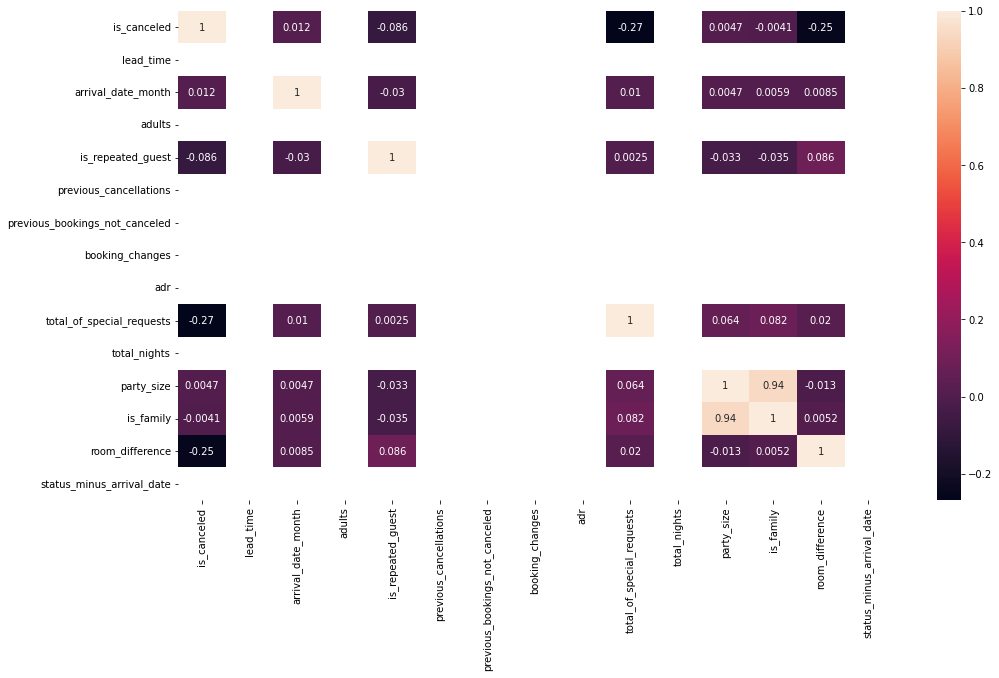

In [31]:
plt.figure(figsize=(16,9))
sns.heatmap(df.corr(method='pearson'),annot=True)
plt.savefig('./Img/corr_heatmap_win.png')

In [32]:
corr = 0.7

In [33]:
time_bm = []
training_score_bm = []
test_score_bm = []

time_id3 = []
training_score_id3 = []
test_score_id3 = []

time_cart = []
training_score_cart = []
test_score_cart = []

time_nb = []
training_score_nb = []
test_score_nb = []

time_rf = []
training_score_rf = []
test_score_rf = []

time_lr = []
training_score_lr = []
test_score_lr = []

time_knn = []
training_score_knn = []
test_score_knn = []

time_nn = []
training_score_nn = []
test_score_nn = []

time_bc = []
training_score_bc = []
test_score_bc = []

In [34]:
def save_tree_id3(id3, i):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(id3,filled=True,fontsize=10)
  plt.savefig('./Img/Tree/DecisionTreeID3_{0}_win.png'.format(i))

In [35]:
def save_tree_cart(cart, i):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(cart,filled=True,fontsize=10)
  plt.savefig('./Img/Tree/DecisionTreeCart_{0}_win.png'.format(i))

In [36]:
def save_randomForest(rf, i, x_train):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(rf.estimators_[0], filled=True)
  plt.savefig('./Img/Tree/RandomForest_{0}_win.png'.format(i))

In [37]:
def Roc_Img(bm, id3, cart, nb, rf, lr, knn, nn, bc, x_test, y_test, corr, i):
  plt.figure(figsize=(24,12))
  bm_probs = bm.predict_proba(x_test)
  bm_probs = bm_probs[:, 1]
  bm_auc = roc_auc_score(y_test, bm_probs)
  print('No Skill: ROC AUC=%.3f' % (bm_auc))
  bm_fpr, bm_tpr, _ = roc_curve(y_test, bm_probs)
  plt.plot(bm_fpr, bm_tpr, linestyle='--', label='No Skill')

  id3_probs = id3.predict_proba(x_test)
  id3_probs = id3_probs[:, 1]
  id3_auc = roc_auc_score(y_test, id3_probs)
  print('Decision Tree ID3: ROC AUC=%.3f' % (id3_auc))
  id3_fpr, id3_tpr, _ = roc_curve(y_test, id3_probs)
  plt.plot(id3_fpr, id3_tpr, linestyle='--', label='Decision Tree ID3')

  cart_probs = cart.predict_proba(x_test)
  cart_probs = cart_probs[:, 1]
  cart_auc = roc_auc_score(y_test, cart_probs)
  print('Decision Tree Cart: ROC AUC=%.3f' % (cart_auc))
  cart_fpr, cart_tpr, _ = roc_curve(y_test, cart_probs)
  plt.plot(cart_fpr, cart_tpr, linestyle='--', label='Decision Tree Cart')

  nb_probs = nb.predict_proba(x_test)
  nb_probs = nb_probs[:, 1]
  nb_auc = roc_auc_score(y_test, nb_probs)
  print('Naive Bayes: ROC AUC=%.3f' % (nb_auc))
  nb_fpr, nb_tpr, _ = roc_curve(y_test, nb_probs)
  plt.plot(nb_fpr, nb_tpr, linestyle='--', label='Naive Bayes')

  rf_probs = rf.predict_proba(x_test)
  rf_probs = rf_probs[:, 1]
  rf_auc = roc_auc_score(y_test, rf_probs)
  print('Random Forest: ROC AUC=%.3f' % (rf_auc))
  rf_fpr, rf_tpr, _ = roc_curve(y_test, rf_probs)
  plt.plot(rf_fpr, rf_tpr, linestyle='--', label='Random Forest')

  lr_probs = lr.predict_proba(x_test)
  lr_probs = lr_probs[:, 1]
  lr_auc = roc_auc_score(y_test, lr_probs)
  print('Logistic Regression: ROC AUC=%.3f' % (lr_auc))
  lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
  plt.plot(lr_fpr, lr_tpr, linestyle='--', label='Logistic Regression')

  knn_probs = knn.predict_proba(x_test)
  knn_probs = knn_probs[:, 1]
  knn_auc = roc_auc_score(y_test, knn_probs)
  print('K Nearest Neighbors ROC AUC=%.3f' % (knn_auc))
  knn_fpr, knn_tpr, _ = roc_curve(y_test, knn_probs)
  plt.plot(knn_fpr, knn_tpr, linestyle='--', label='K Nearest Neighbors')

  nn_probs = nn.predict_proba(x_test)
  nn_probs = nn_probs[:, 1]
  nn_auc = roc_auc_score(y_test, nn_probs)
  print('Neural Network: ROC AUC=%.3f' % (nn_auc))
  nn_fpr, nn_tpr, _ = roc_curve(y_test, nn_probs)
  plt.plot(nn_fpr, nn_tpr, linestyle='--', label='Neural Network')

  bc_probs = bc.predict_proba(x_test)
  bc_probs = bc_probs[:, 1]
  bc_auc = roc_auc_score(y_test, bc_probs)
  print('Bagging Classifier: ROC AUC=%.3f' % (bc_auc))
  bc_fpr, bc_tpr, _ = roc_curve(y_test, bc_probs)
  plt.plot(bc_fpr, bc_tpr, linestyle='--', label='Bagging Classifier')

  # axis labels
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.legend()
  plt.savefig('./Img/Roc/{0}_{1}_win.png'.format(corr, i))

In [38]:
def get_score(x_train, x_test, y_train, y_test, i):
  print("-----Baseline Model-----")
  start= time.time()
  bm = DummyClassifier(strategy='most_frequent', random_state=0)
  bm.fit(x_train, y_train)
  end = time.time()
  time_bm.append(end - start)
  training_score_bm.append(bm.score(x_train, y_train))
  bm_pred = bm.predict(x_test)
  bm_score = metrics.accuracy_score(y_test, bm_pred)
  test_score_bm.append(bm_score)
  print("Baseline Model")
  print("Accruracy:",bm_score)
  print("Report:",metrics.classification_report(y_test,bm_pred))
  bm_cm = metrics.confusion_matrix(y_test,bm_pred)
  
  print("-----Decision Tree ID3-----")
  start= time.time()
  id3 = tree.DecisionTreeClassifier(criterion="entropy",random_state=0)
  id3.fit(x_train,y_train)
  end = time.time()
  time_id3.append(end - start)
  training_score_id3.append(id3.score(x_train, y_train))
  id3_pred = id3.predict(x_test)
  id3_score = metrics.accuracy_score(y_test, id3_pred)
  test_score_id3.append(id3_score)
  print("Decision Tree ID3")
  print("Accruracy:",id3_score)
  print("Report:",metrics.classification_report(y_test,id3_pred))
  id3_cm = metrics.confusion_matrix(y_test,id3_pred)
  save_tree_id3(id3, i)
  
  print("-----Decision Tree Cart-----")
  start= time.time()
  cart = tree.DecisionTreeClassifier(criterion="gini",random_state=0)
  cart.fit(x_train,y_train)
  end = time.time()
  time_cart.append(end - start)
  training_score_cart.append(cart.score(x_train, y_train))
  cart_pred = cart.predict(x_test)
  cart_score = metrics.accuracy_score(y_test, cart_pred)
  test_score_cart.append(cart_score)
  print("Decision Tree Cart")
  print("Accruracy:",cart_score)
  print("Report:",metrics.classification_report(y_test,cart_pred))
  cart_cm = metrics.confusion_matrix(y_test,cart_pred)
  save_tree_cart(cart, i)
  
  print("-----Naive Bayes-----")
  start= time.time()
  nb = GaussianNB()
  nb.fit(x_train,y_train)
  end = time.time()
  time_nb.append(end - start)
  training_score_nb.append(nb.score(x_train, y_train))
  nb_pred = nb.predict(x_test)
  nb_score = metrics.accuracy_score(y_test, nb_pred)
  test_score_nb.append(nb_score)
  print("Naive Bayes")
  print("Accruracy:",nb_score)
  print("Report:",metrics.classification_report(y_test,nb_pred))
  nb_cm = metrics.confusion_matrix(y_test,nb_pred)
  
  print("-----Random Forest-----")
  start= time.time()
  rf = RandomForestClassifier()
  rf.fit(x_train,y_train)
  end = time.time()
  time_rf.append(end - start)
  training_score_rf.append(rf.score(x_train, y_train))
  rf_pred = rf.predict(x_test)
  rf_score = metrics.accuracy_score(y_test, rf_pred)
  test_score_rf.append(rf_score)
  print("Random Forest")
  print("Accruracy:",rf_score)
  print("Report:",metrics.classification_report(y_test,rf_pred))
  rf_cm = metrics.confusion_matrix(y_test,rf_pred)
  save_randomForest(rf, i, x_train)
  
  print("-----Logistic Regression-----")
  start= time.time()
  lr = LogisticRegression()
  lr.fit(x_train,y_train)
  end = time.time()
  time_lr.append(end - start)
  training_score_lr.append(lr.score(x_train, y_train))
  lr_pred = lr.predict(x_test)
  lr_score = metrics.accuracy_score(y_test, lr_pred)
  test_score_lr.append(lr_score)
  print("Logistic Regression")
  print("Accruracy:",lr_score)
  print("Report:",metrics.classification_report(y_test,lr_pred))
  lr_cm = metrics.confusion_matrix(y_test,lr_pred)
  
  print("-----K-Nearest Neighbor-----")
  start= time.time()
  knn = KNeighborsClassifier()
  knn.fit(x_train,y_train)
  end = time.time()
  time_knn.append(end - start)
  training_score_knn.append(knn.score(x_train, y_train))
  knn_pred = knn.predict(x_test)
  knn_score = metrics.accuracy_score(y_test, knn_pred)
  test_score_knn.append(knn_score)
  print("K-Nearest Neighbor")
  print("Accruracy:",knn_score)
  print("Report:",metrics.classification_report(y_test,knn_pred))
  knn_cm = metrics.confusion_matrix(y_test,knn_pred)
  
  print("-----Neural Network-----")
  start= time.time()
  nn = MLPClassifier(random_state=0, activation="logistic", solver="sgd")
  nn.fit(x_train,y_train)
  end = time.time()
  time_nn.append(end - start)
  training_score_nn.append(nn.score(x_train, y_train))
  nn_pred = nn.predict(x_test)
  nn_score = metrics.accuracy_score(y_test, nn_pred)
  test_score_nn.append(nn_score)
  print("Neural Network")
  print("Accruracy:",nn_score)
  print("Report:",metrics.classification_report(y_test,nn_pred))
  nn_cm = metrics.confusion_matrix(y_test,nn_pred)
  
  print("-----Bagging Classifier-----")
  start= time.time()
  bc = BaggingClassifier(random_state=0)
  bc.fit(x_train,y_train)
  end = time.time()
  time_bc.append(end - start)
  training_score_bc.append(bc.score(x_train, y_train))
  bc_pred = bc.predict(x_test)
  bc_score = metrics.accuracy_score(y_test, bc_pred)
  test_score_bc.append(bc_score)
  print("Bagging Classifier")
  print("Accruracy:",bc_score)
  print("Report:",metrics.classification_report(y_test,bc_pred))
  bc_cm = metrics.confusion_matrix(y_test,bc_pred)

  plt.figure(figsize=(24,12))

  plt.suptitle("Confusion Matrixes",fontsize=24)
  plt.subplots_adjust(wspace = 0.4, hspace= 0.4)

  plt.subplot(5,2,1)
  plt.title("Baseline Confusion Matrix")
  sns.heatmap(bm_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,2)
  plt.title("Decision Tree ID3 Classifier Confusion Matrix")
  sns.heatmap(id3_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,3)
  plt.title("Decision Tree Cart Classifier Confusion Matrix")
  sns.heatmap(cart_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,4)
  plt.title("Naive Bayes Confusion Matrix")
  sns.heatmap(nb_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,5)
  plt.title("Random Forest Confusion Matrix")
  sns.heatmap(rf_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,6)
  plt.title("Logistic Regression Confusion Matrix")
  sns.heatmap(lr_cm, annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,7)
  plt.title("K Nearest Neighbors Confusion Matrix")
  sns.heatmap(knn_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,8)
  plt.title("Neural Network Confusion Matrix")
  sns.heatmap(nn_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,9)
  plt.title("Bagging Classifier Confusion Matrix")
  sns.heatmap(bc_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.savefig('./Img/ConfusionMatrix/{0}_win.png'.format(i))
  Roc_Img(bm, id3, cart, nb, rf, lr, knn, nn,  bc, x_test, y_test, corr, i)


-------------With corr equal: 0.7-------------
Length of corr_feature equal: 1
---------Time: 1---------
-----Baseline Model-----
Baseline Model
Accruracy: 0.6261666431693219
Report:               precision    recall  f1-score   support

           0       0.63      1.00      0.77     22207
           1       0.00      0.00      0.00     13258

    accuracy                           0.63     35465
   macro avg       0.31      0.50      0.39     35465
weighted avg       0.39      0.63      0.48     35465

-----Decision Tree ID3-----
Decision Tree ID3
Accruracy: 0.7924432539123079
Report:               precision    recall  f1-score   support

           0       0.80      0.90      0.84     22207
           1       0.78      0.61      0.69     13258

    accuracy                           0.79     35465
   macro avg       0.79      0.76      0.77     35465
weighted avg       0.79      0.79      0.79     35465

-----Decision Tree Cart-----
Decision Tree Cart
Accruracy: 0.7920766953334273
R

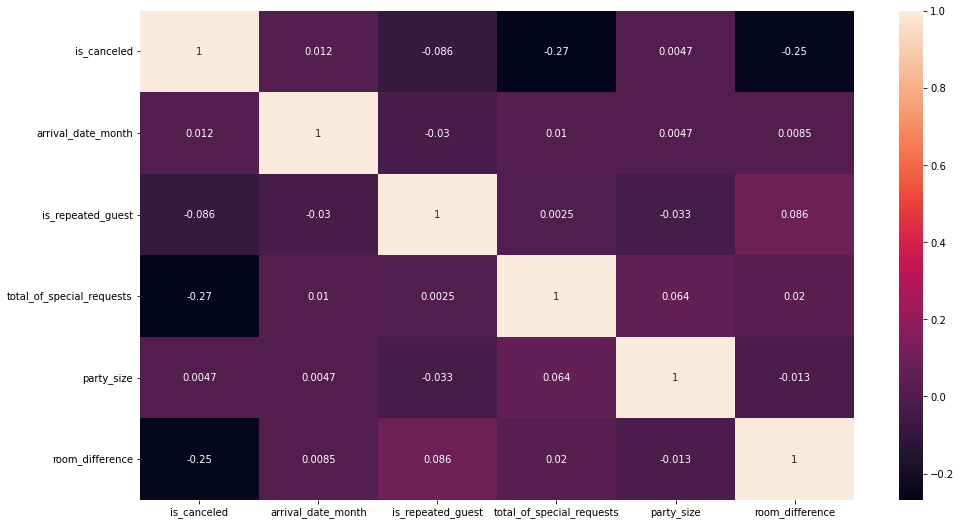

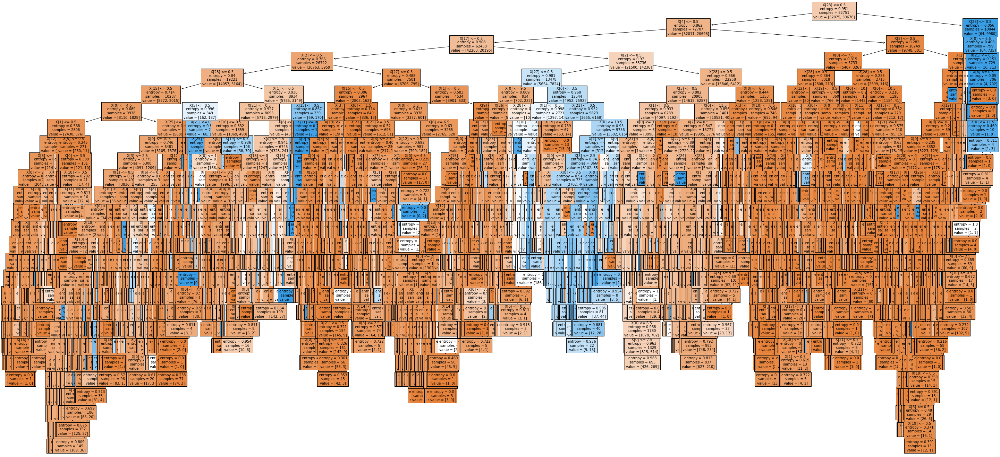

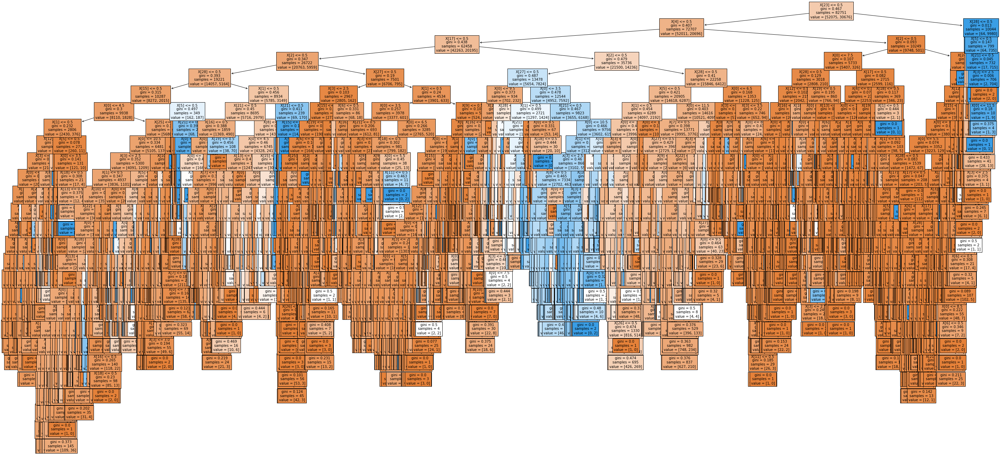

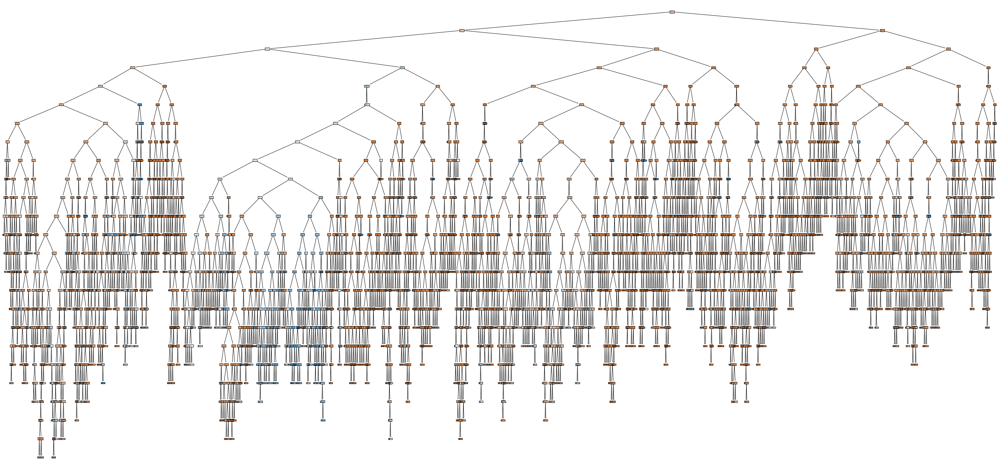

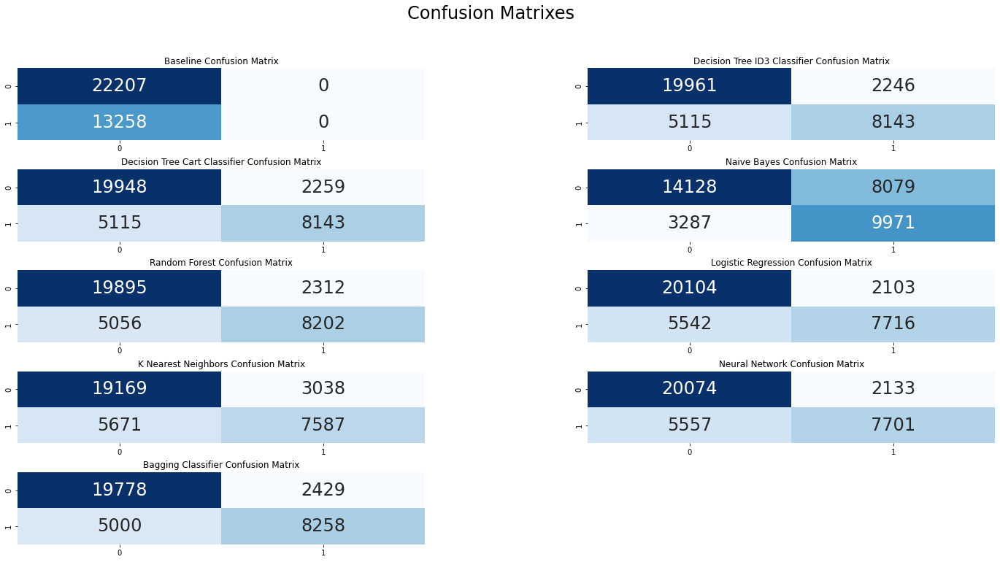

...

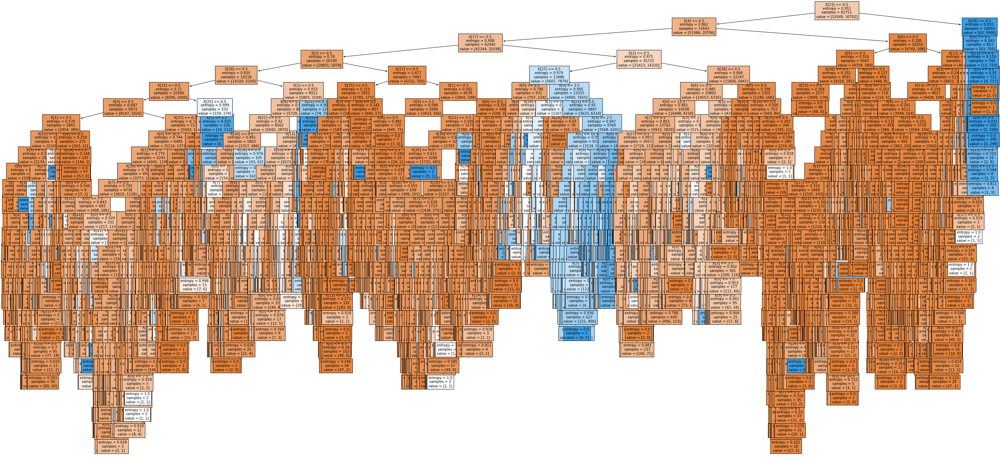

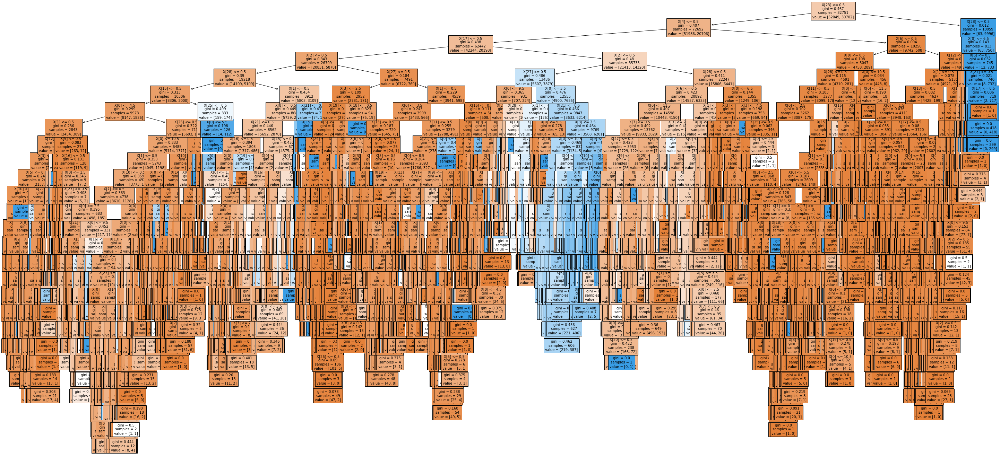

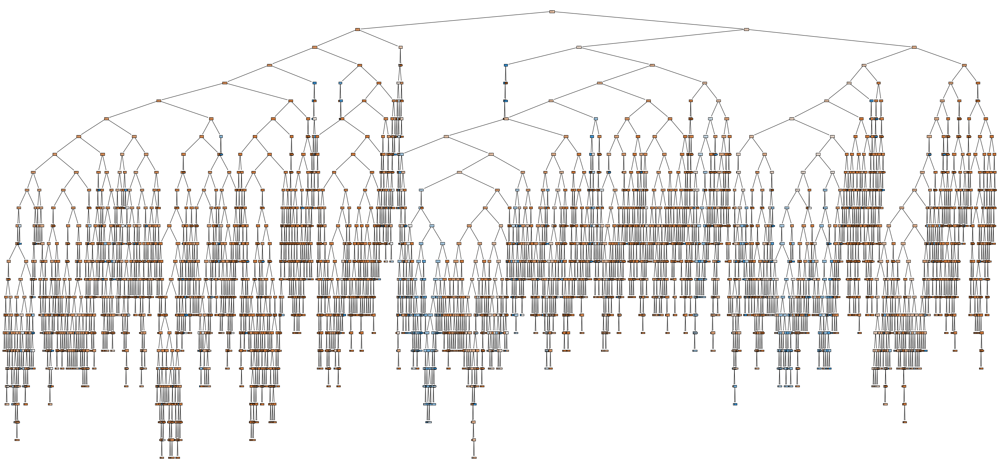

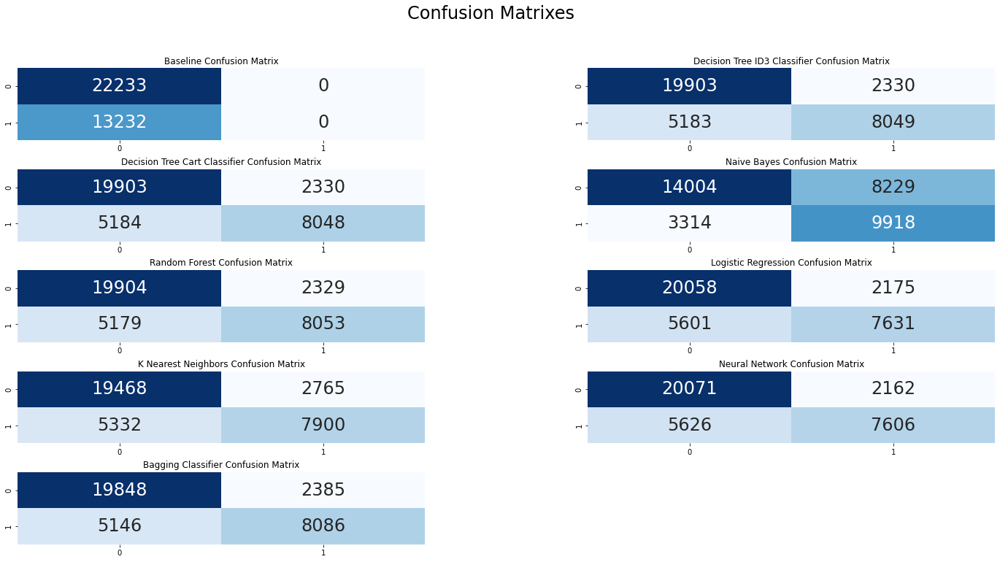

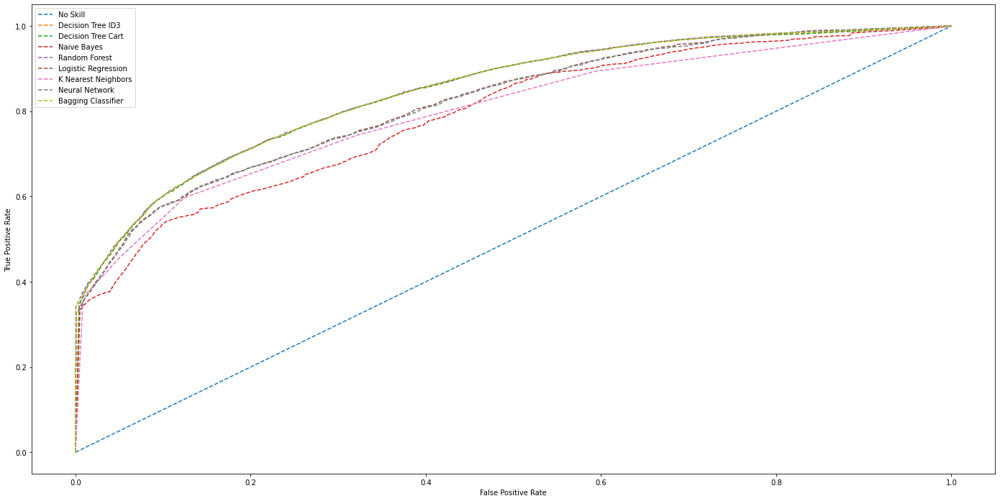

In [39]:
  df1 = df.copy()
  c_features = ['lead_time', 'adults', 'previous_cancellations', 'previous_bookings_not_canceled', 
                'booking_changes', 'adr', 'total_nights', 'status_minus_arrival_date']
  df1 = df1.drop(c_features, axis = 1)
  corr_features = correlation(df1, corr)
  print("-------------With corr equal: {0}-------------".format(corr))
  print("Length of corr_feature equal: {0}".format(len(set(corr_features)))) 
  df1 = df1.drop(corr_features, axis = 1)
  plt.figure(figsize=(16,9))
  sns.heatmap(df1.corr(method='pearson'),annot=True)
  plt.savefig('./Img/corr_heatmap_{0}_win.png'.format(corr))
  
  feature = df1.drop('is_canceled',axis=1)
  label = df1['is_canceled']
  feature_onehot = pd.get_dummies(feature,columns=feature.select_dtypes(exclude=['int64']).columns) 
  folds = ShuffleSplit(n_splits=7, random_state=42, test_size=0.3)
  feature_onehot = np.array(feature_onehot)
  label = np.array(label)
  i = 1
  for train_index, test_index  in folds.split(label):
    print("---------Time: {}---------".format(i))
    x_train, x_test = feature_onehot[train_index], feature_onehot[test_index]
    y_train, y_test = label[train_index], label[test_index]
    get_score(x_train, x_test, y_train, y_test, i)
    i = i + 1


In [40]:
print("-----------------1. Baseline Model-----------------")
print("Time: {}".format(time_bm))
print("Training Acurracy: {}".format(training_score_bm))
print("Test Acurracy: {}".format(test_score_bm))

-----------------1. Baseline Model-----------------
Time: [0.0030150413513183594, 0.004001140594482422, 0.0030012130737304688, 0.0031859874725341797, 0.0030007362365722656, 0.0, 0.0]
Training Acurracy: [0.6292975311476598, 0.6282703532283598, 0.6293579533782069, 0.6278232287223116, 0.6269048108179962, 0.6292250244710034, 0.6289833355488151]
Test Acurracy: [0.6261666431693219, 0.6285633723389257, 0.6260256591005217, 0.6296066544480474, 0.6317496122938108, 0.6263358240518822, 0.626899760327083]


In [41]:
print("-----------------2. Decision Tree ID3-----------------")
print("Time: {}".format(time_id3))
print("Training Acurracy: {}".format(training_score_id3))
print("Test Acurracy: {}".format(test_score_id3))


-----------------2. Decision Tree ID3-----------------
Time: [0.2656078338623047, 0.4061555862426758, 0.22623705863952637, 0.2555983066558838, 0.2239995002746582, 0.2263023853302002, 0.21963715553283691]
Training Acurracy: [0.7981414121883723, 0.7992652656765478, 0.7991081678771254, 0.7985522833560924, 0.7989269011854842, 0.7992773501226571, 0.8001353457964254]
Test Acurracy: [0.7924432539123079, 0.7885238967996616, 0.7897645566051036, 0.7925560411673481, 0.790018327928944, 0.7892288171436628, 0.788157338220781]


In [42]:
print("-----------------3. Decision Tree Cart-----------------")
print("Time: {}".format(time_cart))
print("Training Acurracy: {}".format(training_score_cart))
print("Test Acurracy: {}".format(test_score_cart))


-----------------3. Decision Tree Cart-----------------
Time: [0.22311806678771973, 0.27906298637390137, 0.21821141242980957, 0.23026442527770996, 0.2636098861694336, 0.23679685592651367, 0.26123523712158203]
Training Acurracy: [0.7981414121883723, 0.7992652656765478, 0.7991081678771254, 0.7985522833560924, 0.7989269011854842, 0.7992773501226571, 0.8001353457964254]
Test Acurracy: [0.7920766953334273, 0.788749471309742, 0.7898491470463838, 0.7922458762159876, 0.7901311151839842, 0.7890878330748625, 0.7881291414070211]


In [43]:
print("-----------------4. Naive Bayes-----------------")
print("Time: {}".format(time_nb))
print("Training Acurracy: {}".format(training_score_nb))
print("Test Acurracy: {}".format(test_score_nb))


-----------------4. Naive Bayes-----------------
Time: [0.03822779655456543, 0.03815484046936035, 0.03740072250366211, 0.04020357131958008, 0.029996633529663086, 0.046060800552368164, 0.047011375427246094]
Training Acurracy: [0.6732849149859216, 0.6650312382931929, 0.6722335681744027, 0.6654904472453506, 0.6722214837282933, 0.6712305591473214, 0.6759193242377736]
Test Acurracy: [0.6795150148033272, 0.6603975750740166, 0.6711687579303539, 0.6658113633159453, 0.6700408853799521, 0.6694487522909911, 0.6745241787677992]


In [44]:
print("-----------------5. Random Forest-----------------")
print("Time: {}".format(time_rf))
print("Training Acurracy: {}".format(training_score_rf))
print("Test Acurracy: {}".format(test_score_rf))

-----------------5. Random Forest-----------------
Time: [4.731429815292358, 6.945342540740967, 4.720205783843994, 5.705215692520142, 4.850972890853882, 4.8217222690582275, 6.20741868019104]
Training Acurracy: [0.798129327742263, 0.7992652656765478, 0.7990960834310159, 0.7985281144638735, 0.7989148167393747, 0.7992773501226571, 0.8001353457964254]
Test Acurracy: [0.7922458762159876, 0.7894543916537431, 0.7906950514591851, 0.7927252220499084, 0.7908924291555054, 0.7892852107711829, 0.7882983222895813]


In [45]:
print("-----------------6. Logistic Regression-----------------")
print("Time: {}".format(time_lr))
print("Training Acurracy: {}".format(training_score_lr))
print("Test Acurracy: {}".format(test_score_lr))


-----------------6. Logistic Regression-----------------
Time: [0.4991421699523926, 0.6212272644042969, 0.7177331447601318, 0.5271022319793701, 0.5303397178649902, 0.514223575592041, 0.6854310035705566]
Training Acurracy: [0.7823470411233701, 0.7839059346714843, 0.7825524767072302, 0.7822745344467137, 0.7821416055395101, 0.7827820811833089, 0.7832292056893573]
Test Acurracy: [0.7844353588044551, 0.7824615818412519, 0.7822078105174115, 0.7846327365007754, 0.7833638798815734, 0.7827435499788524, 0.7807415762018892]


In [46]:
print("-----------------7. K-Nearest Neighbor-----------------")
print("Time: {}".format(time_knn))
print("Training Acurracy: {}".format(training_score_knn))
print("Test Acurracy: {}".format(test_score_knn))


-----------------7. K-Nearest Neighbor-----------------
Time: [0.0030007362365722656, 0.005918979644775391, 0.005106449127197266, 0.003999948501586914, 0.003318309783935547, 0.01562643051147461, 0.00500178337097168]
Training Acurracy: [0.7595678602071274, 0.7626614784111371, 0.7567038464791966, 0.756305059757586, 0.7688245459269374, 0.7534893838140929, 0.7779603871856533]
Test Acurracy: [0.7544339489637671, 0.7533342732271253, 0.7493021288594389, 0.7524601720005639, 0.7612011842661779, 0.7477513041026363, 0.7716903989849146]


In [47]:
print("-----------------8. Neural Network-----------------")
print("Time: {}".format(time_nn))
print("Training Acurracy: {}".format(training_score_nn))
print("Test Acurracy: {}".format(test_score_nn))

-----------------8. Neural Network-----------------
Time: [34.92758584022522, 32.73545980453491, 33.0911078453064, 38.42025709152222, 33.752549171447754, 36.77770185470581, 45.37167429924011]
Training Acurracy: [0.7811748498507571, 0.7827458278449807, 0.7825162233689019, 0.7816944810334618, 0.7813561165423982, 0.7828183345216372, 0.7831083612282631]
Test Acurracy: [0.7831665021852531, 0.7811927252220499, 0.7815592838009305, 0.7845481460594953, 0.7827435499788524, 0.7820104328210912, 0.7804032144367686]


In [48]:
print("-----------------9. Bagging Classifier-----------------")
print("Time: {}".format(time_bc))
print("Training Acurracy: {}".format(training_score_bc))
print("Test Acurracy: {}".format(test_score_bc))


-----------------9. Bagging Classifier-----------------
Time: [1.6422724723815918, 1.507767677307129, 1.7803282737731934, 1.609457015991211, 1.8360247611999512, 1.9092953205108643, 1.8356618881225586]
Training Acurracy: [0.7976580343439958, 0.7986489589249677, 0.7986610433710771, 0.798129327742263, 0.7985522833560924, 0.7989027322932654, 0.799857403535909]
Test Acurracy: [0.7905258705766248, 0.7888058649372621, 0.7891160298886226, 0.7921330889609474, 0.790638657831665, 0.7888904553785422, 0.7876497955731002]


<h3>Phân tích đánh giá các thuật toán và dự báo

In [49]:
def mean(lst):
    return sum(lst) / len(lst)

<li>Đánh giá thời gian chạy của thuật toán

In [50]:
df_time = pd.DataFrame(data=[('Baseline',mean(time_bm)), ('Decision Tree ID3',mean(time_id3)), ('Decision Tree Cart',mean(time_cart)), 
                             ('Naive Bayes',mean(time_nb)), ('Random Forest',mean(time_rf)), ('Logistic Regression',mean(time_lr)), 
                             ('K-Nearest Neighbor',mean(time_knn)), ('Neural Network',mean(time_nn)),
                             ('Bagging Classifier',mean(time_bc))],
                                       columns=['Model', 'Time'])

In [51]:
df_time

,Model,Time
0,Baseline,0.002315
1,Decision Tree ID3,0.260505
2,Decision Tree Cart,0.244614
3,Naive Bayes,0.039579
4,Random Forest,5.426044
5,Logistic Regression,0.585028
6,K-Nearest Neighbor,0.005996
7,Neural Network,36.439477
8,Bagging Classifier,1.731544


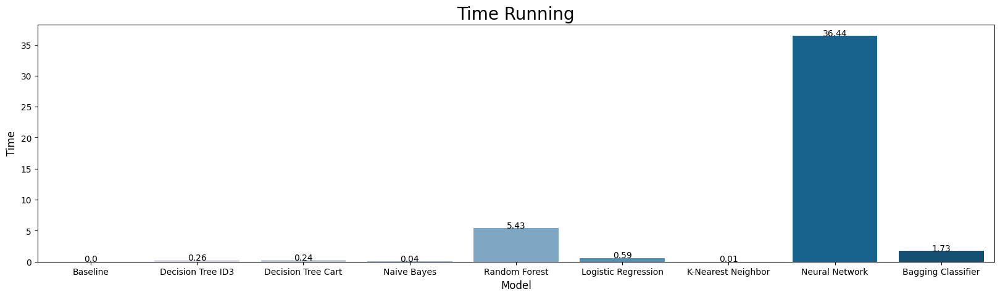

In [52]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Time', data=df_time, palette='PuBu')
plt.title('Time Running', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Time', fontsize = 12)
for index, row in df_time.iterrows():
    p.text(x=row.name, y=row.Time, s=round(row.Time,2), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Thời gian chạy của thuật toán KNN nhanh nhất khi loại bỏ mô hình Baseline.
*   Thời gian chạy của thuật toán Neural Network chậm nhất trong tất cả các thuật toán.



<li>Đánh giá độ chính xác của thuật toán

<strong>Độ chính xác của tập dữ liệu đào tạo

In [53]:
df_train = pd.DataFrame(data=[('Baseline',mean(training_score_bm)), ('Decision Tree ID3',mean(training_score_id3)), ('Decision Tree Cart',mean(training_score_cart)), 
                             ('Naive Bayes',mean(training_score_nb)), ('Random Forest',mean(training_score_rf)), ('Logistic Regression',mean(training_score_lr)), 
                             ('K-Nearest Neighbor',mean(training_score_knn)), ('Neural Network',mean(training_score_nn)), 
                             ('Bagging Classifier',mean(training_score_bc))],
                                       columns=['Model', 'Accuracy'])

In [54]:
df_train

,Model,Accuracy
0,Baseline,0.628552
1,Decision Tree ID3,0.799058
2,Decision Tree Cart,0.799058
3,Naive Bayes,0.670773
4,Random Forest,0.799049
5,Logistic Regression,0.782748
6,K-Nearest Neighbor,0.762216
7,Neural Network,0.782202
8,Bagging Classifier,0.798630


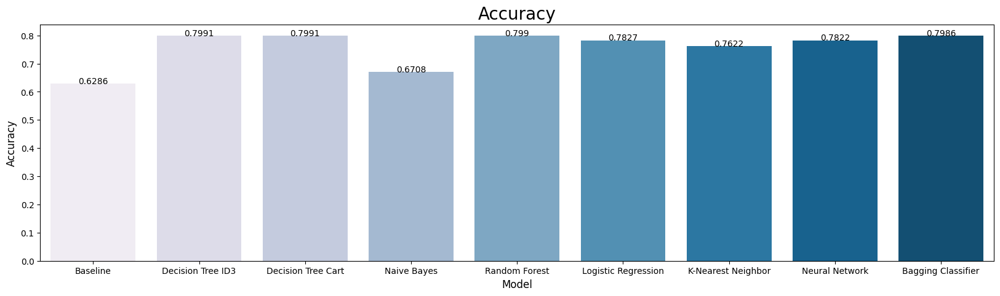

In [55]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_train, palette='PuBu')
plt.title('Accuracy', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_train.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Độ chính xác hai mô hình Decision Tree cao nhất so với các mô hình còn lại.
*   Độ chính xác của Naive Bayes là thấy nhất khi loại trừ Baseline Model.



<strong>Độ hính xác của tập dữ liệu kiểm tra

In [56]:
df_test = pd.DataFrame(data=[('Baseline',mean(test_score_bm)), ('Decision Tree ID3',mean(test_score_id3)), ('Decision Tree Cart',mean(test_score_cart)), 
                             ('Naive Bayes',mean(test_score_nb)), ('Random Forest',mean(test_score_rf)), ('Logistic Regression',mean(test_score_lr)), 
                             ('K-Nearest Neighbor',mean(test_score_knn)), ('Neural Network',mean(test_score_nn)),
                             ('Bagging Classifier',mean(test_score_bc))],
                                       columns=['Model', 'Accuracy'])

In [57]:
df_test

,Model,Accuracy
0,Baseline,0.627907
1,Decision Tree ID3,0.790099
2,Decision Tree Cart,0.790038
3,Naive Bayes,0.670130
4,Random Forest,0.790514
5,Logistic Regression,0.782941
6,K-Nearest Neighbor,0.755739
7,Neural Network,0.782232
8,Bagging Classifier,0.789680


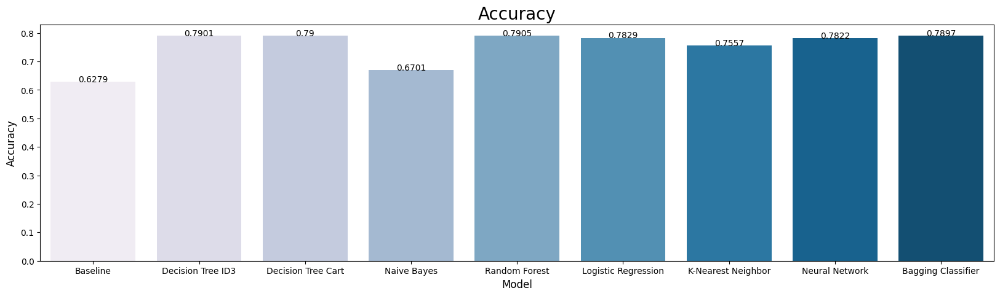

In [58]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_test, palette='PuBu')
plt.title('Accuracy', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_test.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Độ chính xác khi tiến hành kiểm tra của Decision Tree ID3 nhỉnh hơn chút so với Decision Tree Cart.
*   Tương tự trong mô hình huấn luyện,mô hình Naive Bayes có độ chính xác thấp.

